In [21]:
from torchvision import transforms, models 
import torch
from PIL import Image
from matplotlib.pyplot import imshow
import matplotlib.pyplot as plt
from torch.autograd import Variable
from torch.nn import functional as F
from torch import topk #return max element in dim (can return K-max elements)
import numpy as np
import skimage.transform
from torchvision.models import resnet50, ResNet50_Weights
import math
import os
from sklearn.decomposition import PCA


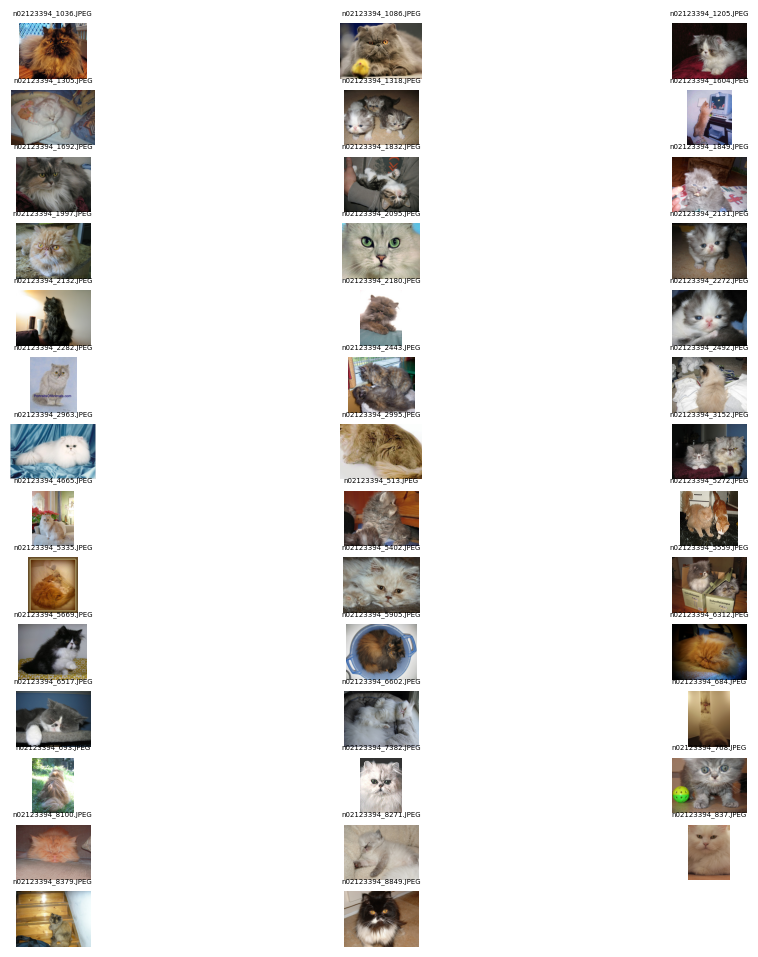

In [22]:
# pics_mapping return list of Image and show images in set
PATH_TO_SET = 'catset'

def imageMapping(path: str, row: int = 2, col: int = 3) -> list:
    listDir = os.listdir(path)
    listImage = []
    row = math.ceil(len(listDir)/3)
    fig = plt.figure(figsize=(12, 12))
    for pcs in range(len(listDir)):
        fig.add_subplot(row, col, pcs+1)
        listImage.append(Image.open(os.path.join(path, str(listDir[pcs]))))
        plt.imshow(Image.open(os.path.join(path, str(listDir[pcs]))))
        plt.title(label=listDir[pcs], fontsize=5)
        plt.axis('off')
    return listImage

listImage = imageMapping(PATH_TO_SET)        

In [23]:
# regular preprocessing for Image, return torch.tensor ([1, 3, 224, 224])  
 
def preprocessingImage(listImage : list) -> list:

    preprocessingCallable = transforms.Compose([
        
    transforms.Resize((224,224)),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]),
    transforms.Compose([transforms.Resize((224,224))])
    ])
    
    return [Variable((preprocessingCallable(image).unsqueeze(0)), requires_grad=False) \
                                                             for image in listImage]
                        
preprocessingList = preprocessingImage(listImage)
print(len(preprocessingList), '\n', preprocessingList[0].shape)


41 
 torch.Size([1, 3, 224, 224])


In [24]:

model = models.resnet50()
model.load_state_dict(torch.load('./resnet50-0676ba61.pth'))
model.eval()
print()


In [25]:
# Hook facility recall every time after forward function will be call
class Hook(): 
    features = []
    def __init__(self, m): 
        self.hook = m.register_forward_hook(self.hookFunc)
    def hookFunc(self, module, input, output):
        self.features.append(output.clone().detach())
    def remove(self):
        self.hook.remove()
    def clearFeatures(self):
        self.features.clear()

In [26]:
# Method return list of activision values
def actLayerMethod(model: torch.nn.Module, preprocessingList: list, \
                   layer: str = 'layer4') -> list:
    hookForLayer = Hook(model._modules.get(layer))
    predictionList = [model(pred) for pred in preprocessingList]    
    hookForLayer.remove() 
    features = hookForLayer.features.copy()
    hookForLayer.clearFeatures()
    return features, predictionList

features, predictionList = actLayerMethod(model, preprocessingList)                                       
print('act_len', len(features), '\nact_shape:', features[0].size())
                                       

act_len 41 
act_shape: torch.Size([1, 2048, 7, 7])


In [27]:
# Method return max idx for prediction list. Len accordance to len of dataset
def maxActivisionValue(predicitionList : list) -> list:
    return [torch.squeeze(topk(pred, 1)[1].int()).numpy()\
                                         for pred in predicitionList]


#Do we need a hook for FC?
# prediction_list
# idx = topk(prediction_list[0], 1)[1].int() #283
# idx_list = [topk(pred, 1)[1].int() for pred in prediction_list]
# print('idx:', idx, '\nidx_list:', len(idx_list))
# list_for_set = [torch.squeeze(lt).tolist() for lt in idx_list]
# idx_numpy_type = [torch.squeeze(lt).numpy() for lt in idx_list]
# print('Number of class type:', set(list_for_set))
# listdir = os.listdir('catset')


    
# respectation = [{i:j} for i, j in zip(listdir, idx_numpy_type)]
# print(respectation)
indexNumpy = maxActivisionValue(predictionList)
# len(idx_numpy_type)

In [31]:
weight_softmax_params = list(model._modules.get('fc').parameters())
print(weight_softmax_params[0].shape)
weight_softmax = np.squeeze(list(model._modules.get('fc').parameters())[0].cpu().data.numpy())
print('2048 -> 1000 classes:', weight_softmax.shape)
print(type(weight_softmax))

# Need for FC layer, but can gain weight from other layers with squeeze 2 last dimension 
def weightFromLayer(model : torch.nn.Module, layer : str = 'fc') -> np.ndarray: 
    return np.squeeze(list(model._modules.get(layer).parameters())[0].cpu().data.numpy())
weightFromLayer(model, 'layer4').shape

torch.Size([1000, 2048])
2048 -> 1000 classes: (1000, 2048)
<class 'numpy.ndarray'>


(512, 1024)

In [29]:
#     idx_numpy_type = max_activision_value(prediction_list)    
#     features, prediction_list = act_layer_method(model, preproc_list) 

# Method creates CAM for one pcs and for set of CAM
def camMethod(features, weight, index):
    features = features.cpu().data.numpy()
    _, nc, h, w = features.shape
    imp = weight[index].dot(features.reshape((nc, h*w))).reshape(h, w)
    cam = imp - np.min(imp)
    cam = cam / np.max(cam)
    return cam

weight = np.squeeze(list(model._modules.get('fc').parameters())[0]\
                            .cpu().data.numpy())

# Method for Set 
def camForSet(actFeatures: list, weight: np.ndarray, index: list) -> list:
       return [camMethod(act, weight, idx) 
               for act, idx in zip(actFeatures, index)]
    
# map_pictures = CAM(features[0], weight_softmax, idx_numpy_type[0])
camFromPictures = camForSet(features, weight, indexNumpy)
print('size of map:', camFromPictures[0].shape, '\nlen of map_pictures:', len(camFromPictures))
print(type(camFromPictures[0]))

size of map: (7, 7) 
len of map_pictures: 41
<class 'numpy.ndarray'>


In [30]:
# Visualization for CAM set 
def visualizationCAM(path : str, camForPictures : np.ndarray, col : int = 2) -> None:
    listDir = os.listdir(path)
    row = math.ceil(len(listDir)/col)
    fig = plt.figure(figsize=(128, 128))
    display = transforms.Compose([transforms.Resize((224,224))])

    for pcs in range(len(listDir)):
        fig.add_subplot(row, col, pcs+1)
        plt.imshow(display(Image.open(os.path.join(path, str(listDir[pcs])))))
        plt.imshow(skimage.transform.resize(camForPictures[pcs], 
                                 [224, 224]), 
                                 alpha=0.7, 
                                 cmap='jet')
        
        plt.title(label=listDir[pcs], fontsize=5)
        plt.axis('off')
       
visualizationCAM(PATH_TO_SET, CAM_for_pictures)

In [16]:
# represent 7x7 to vector 49 length

def vector_from_CAM(out_feature, sum_weight, idx):
    out_feature = out_feature.cpu().data.numpy()
    _, nc, h, w = out_feature.shape
    imp = sum_weight[idx].dot(out_feature.reshape((nc, h*w)))
    cam = imp - np.min(imp)
    cam = cam / np.max(cam)
    return cam

def vector_for_set(act_features: list, weight: np.ndarray, idx: list) -> list:
       return [vector_from_CAM(act_features, weight, idx) 
               for act_features, idx in zip(features, idx_numpy_type)]
    
# map_pictures = CAM(features[0], weight_softmax, idx_numpy_type[0])
vectors = vector_for_set(features, weight_softmax, idx_numpy_type)
print('size of vectors:', vectors[0].shape, '\nlen of vectors:', len(vectors))
print(type(vectors[0]))

size of vectors: (49,) 
len of vectors: 41
<class 'numpy.ndarray'>


In [75]:
vectors_np = np.array(vectors).T #41 measurement; 49 features -> 49 x 41
print(vectors_np)

[[0.07824431 0.05514535 0.03124328 ... 0.10962784 0.03719596 0.02902915]
 [0.11183503 0.12912126 0.01646148 ... 0.22299318 0.02161236 0.16165969]
 [0.18116839 0.34587494 0.01590468 ... 0.21290237 0.01338355 0.27283472]
 ...
 [0.03764975 0.12615415 0.29102895 ... 0.         0.5160149  0.27853924]
 [0.04664617 0.17046021 0.18149859 ... 0.1622596  0.34716716 0.18171167]
 [0.12054765 0.19331081 0.09380173 ... 0.12977992 0.12299554 0.00363326]]


In [76]:
# (49, 41) size of vector

def PCA_on_hand(vectors_np : np.ndarray, ncomp : int):
    mean_vec = [vectors_np[i] - vectors_np[i].mean() for i in range(vectors_np.shape[0])]
    cov_matrix = np.cov(mean_vec)
    print(type(cov_matrix[0][0]), cov_matrix.shape)

    eigenvalues, eigenvectors = np.linalg.eig(cov_matrix)
    idx = eigenvalues.argsort()[::-1]
    eigenvalues_sorted = eigenvalues[idx]
    eigenvectors = eigenvectors[:, idx]
    # print('eigenvec: ', eigenvectors.real, 'eigenval: ', eigenvalues_sorted.real)

    explained_var = np.cumsum(eigenvalues_sorted).real / np.sum(eigenvalues_sorted).real
    # print('cumsum: ', np.cumsum(eigenvalues_sorted).real)
    # print('sum: ', np.sum(eigenvalues_sorted).real)
    # explained_var.real
#     n_comp = np.argmax(explained_var >= 0.95) + 1
#     print(n_comp)
    print('handle number: ', ncomp)
    u_41_ncomp = eigenvectors[:, :ncomp]

    vectors_pca_hand = np.dot(u_41_ncomp.T, vectors_np)
    print('vectors_pca_hand: ', vectors_pca_hand.shape)
    print('u_41_ncomp: ', u_41_ncomp.shape)

    restored = np.array([(np.dot(vectors_pca_hand.T, u_41_ncomp[i]) + vectors_np[i].mean()) \
                        for i in range(vectors_np.shape[0])])

    return vectors_pca_hand.T.real, restored.T.real
ncomp = 36
vec_pca, restored = PCA_on_hand(vectors_np, ncomp = 36)
print(vec_pca.shape, restored.shape)

<class 'numpy.float64'> (49, 49)
handle number:  36
vectors_pca_hand:  (36, 41)
u_41_ncomp:  (49, 36)
(41, 36) (41, 49)


In [77]:
restored_reshape = np.array([restored_t[i].real.reshape(7,7)\
               for i in range(restored_t.shape[0])])   


pca_reshape = np.array([vectors_pca_hand[i].real \
            .reshape(int(math.sqrt(n_comp)),int(math.sqrt(n_comp))) \
               for i in range(vectors_pca_hand.shape[0])])

# image_CAM_on_pcs(path, vectors_reshape)
# image_CAM_on_pcs(path, restored_reshape)        

In [79]:
image_CAM_on_pcs(path, restored_reshape)

In [83]:
# (49, 41)

ncomp = 25
vectors_np = np.array(vectors).T #41 measurement; 49 features -> 49 x 41
print(vectors_np.shape)

def PCA_for_vectors(vectors : np.ndarray, ncomp : int) -> None:
    pca = PCA(n_components = ncomp)
    vector_pca = pca.fit_transform(vectors_np)
    return np.array([vector_pca[i] \
            .reshape(int(math.sqrt(ncomp)), int(math.sqrt(ncomp))) \
               for i in range(vector_pca.shape[0])])        
pca_frombox = PCA_for_vectors(vectors_np, ncomp)

image_CAM_on_pcs(path, pca_frombox)

(49, 41)


In [80]:
from sklearn.cluster import KMeans
import seaborn as sns
import matplotlib.cm as cm
vector_kn = vectors_np
print(vector_kn.shape)
print(type(vector_kn))

(49, 41)
<class 'numpy.ndarray'>


In [90]:
# sse = []
# for k in range(1, 6):
#     km = KMeans(n_clusters=k, random_state=0, n_init="auto").fit(vector_kn)
#     sse.append(km.inertia_)
X = np.array([[1, 2], [1, 4], [1, 3], [10, 2], [10, 4], [10, 3]])    
print(type(X))
print(X.shape)
km = KMeans(n_clusters=2, random_state=0, n_init="auto").fit(X.T)


<class 'numpy.ndarray'>
(6, 2)


AttributeError: 'NoneType' object has no attribute 'split'

In [ ]:
sns.set_style('whitegrid')
g=sns.lineplot(x=range(1,6), y=sse)
g.set(xlabel = 'Number of cluster (k)',
      ylabel = 'Sum squared Error',
      title = 'Elbow Method')
plt.show()

In [ ]:
km.cluster_centers_.shape

In [ ]:
pred = km.fit_predict(vector_kn)
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.scatter(vector_kn[:, 4], vector_kn[:, 5], c = pred, cmap=cm.Accent)
plt.grid(True)
for center in km.cluster_centers_:
    center = center[:4]
    plt.scatter(center[0], center[1], marker='^', c='red')
    plt.xlabel('feature ONE')
    plt.ylabel('feature TWO')